## Contours in OpenCV

Install OpenCV via pip. Note that we need opencv-contrib-python for some of the future exercises (though it's enough to install just `opencv-python` for this one).

In [1]:
!pip install opencv-contrib-python

In [2]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline


import cv2 as cv
from skimage import io
from skimage.io import imread
from scipy.signal import convolve2d

Tasks: 
0. Load contours_exercise.jpg
1. Estimate edges
2. Count the number of items (= the number of external contours)
3. Count the number of green items
4. Count the number of rectangular items (including square ones)
5. Count the total number of holes

In [3]:
def plot_img(img, cmap='gray'):
    plt.figure(figsize=(12,6))
    plt.imshow(img, cmap=cmap)
    plt.axis('on')
    plt.show()

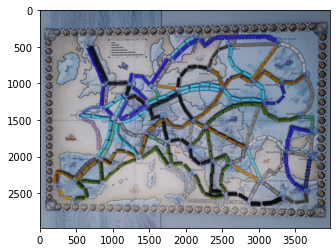

In [4]:
#img = cv2.imread("black_red_yellow.jpg")
#img_g = cv2.imread("black_red_yellow.jpg", 0)
#img = cv2.imread("black_blue_green.jpg")
#img_g = cv2.imread("black_red_yellow.jpg", 0)
#img = cv.imread("all_not_clean.jpg")
img_g = cv.imread("all_not_clean.jpg", 0)
plt.imshow(img)

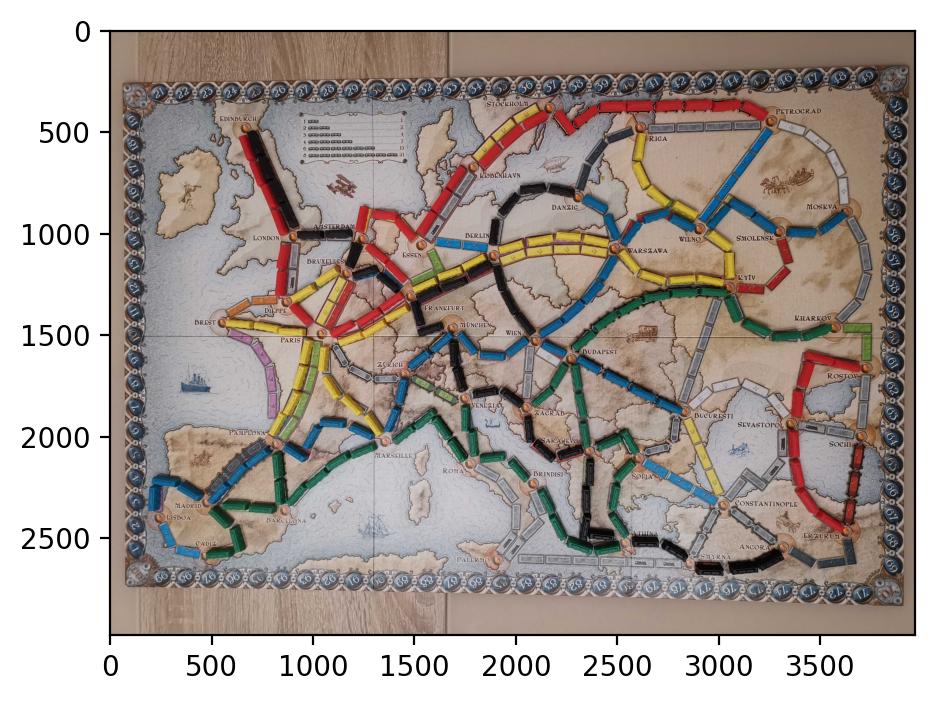

In [5]:
# img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img = img[..., ::-1] #it' the same

plt.figure(dpi=200)
plt.imshow(img)

In [6]:
HLS = cv.cvtColor(img, cv.COLOR_RGB2HLS)


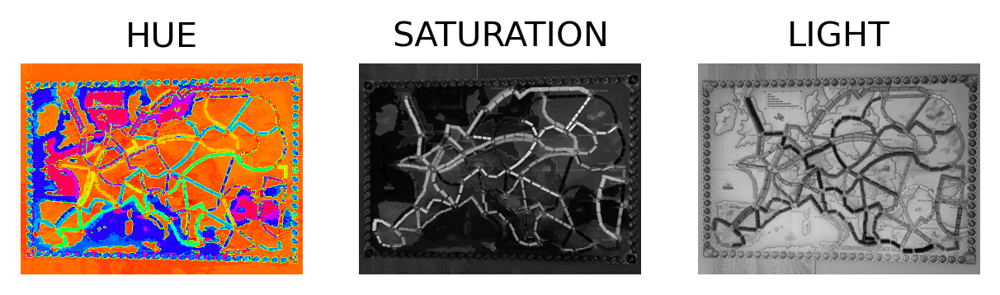

In [7]:
HUE = HLS[:, :, 0]              # Split attributes
LIGHT = HLS[:, :, 1]
SAT = HLS[:, :, 2]

plt.figure(dpi=250)
plt.subplot(1,3,1)              # Plot color attributes
plt.imshow(HUE, cmap='hsv')
plt.title('HUE')
plt.axis('off')
plt.subplot(1,3,2)
plt.imshow(SAT, cmap='gray')
plt.title('SATURATION')
plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(LIGHT, cmap='gray')
plt.title('LIGHT')
plt.axis('off')
plt.show()

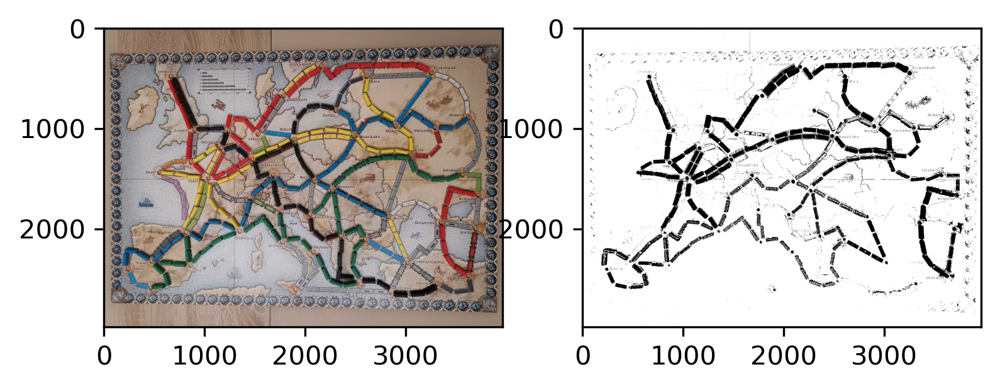

In [8]:
mask = (SAT < 90) | (SAT > 200)
img2 = img.copy()
# img2[mask] = 0

plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask, cmap="gray")

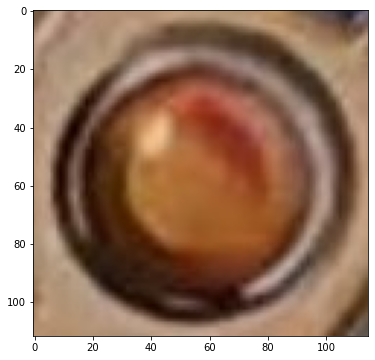

In [9]:
template = cv.imread("template.jpg")
template = template[..., ::-1]
plot_img(template, cmap="gray")

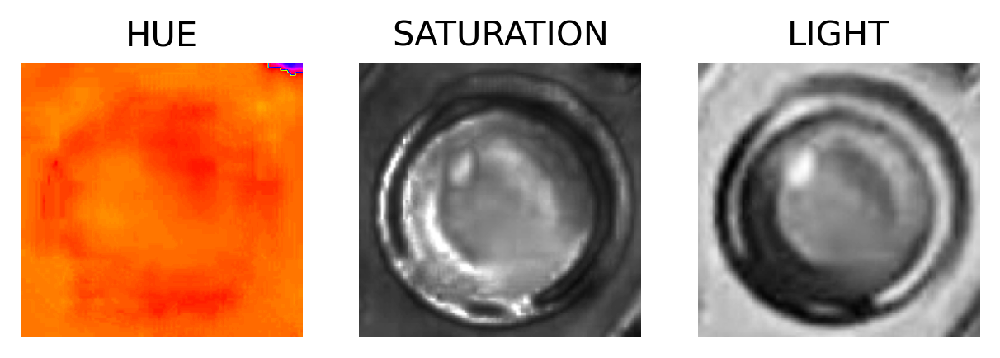

In [10]:
HLS_temp = cv.cvtColor(template, cv.COLOR_RGB2HLS)
HUE_temp = HLS_temp[:, :, 0]              # Split attributes
LIGHT_temp = HLS_temp[:, :, 1]
SAT_temp = HLS_temp[:, :, 2]

plt.figure(dpi=250)
plt.subplot(1,3,1)              # Plot color attributes
plt.imshow(HUE_temp, cmap='hsv')
plt.title('HUE')
plt.axis('off')
plt.subplot(1,3,2)
plt.imshow(SAT_temp, cmap='gray')
plt.title('SATURATION')
plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(LIGHT_temp, cmap='gray')
plt.title('LIGHT')
plt.axis('off')
plt.show()

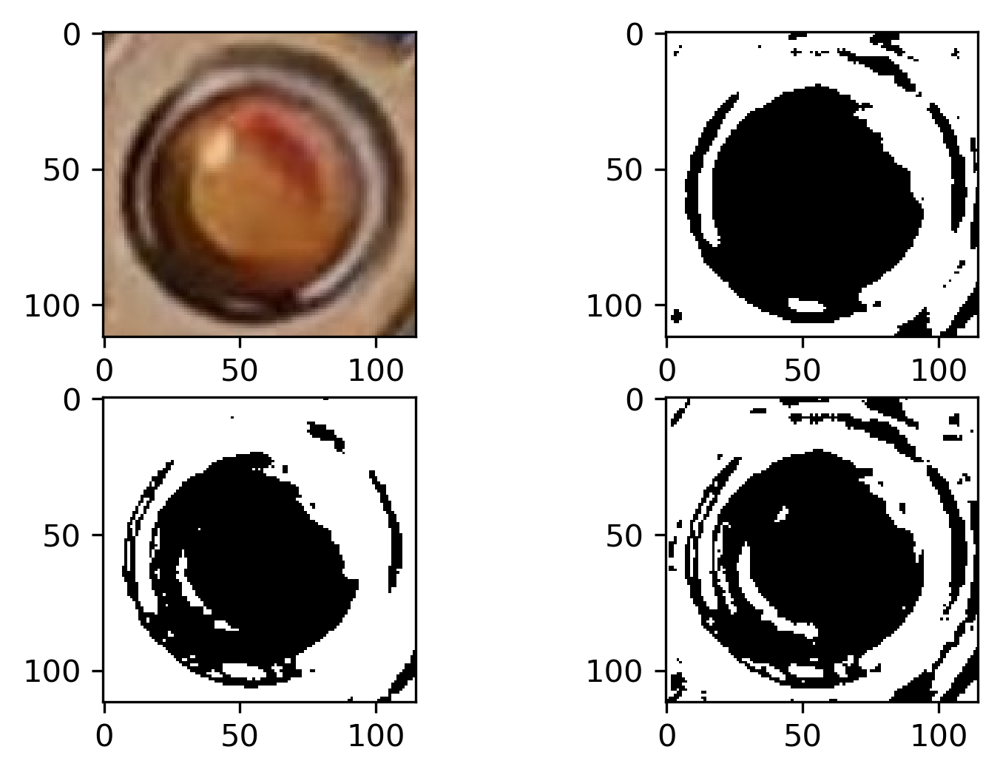

In [11]:
mask1 = (SAT_temp < 85) | (SAT_temp> 270)
mask2 = (SAT_temp < 98) | (SAT_temp > 230)
mask3 = (SAT_temp < 80) | (SAT_temp > 200)
template2 = template.copy()


plt.figure(dpi=300)
plt.subplot(2,2,1)   
# plt.axis('off')
plt.imshow(template2,cmap="gray")
plt.subplot(2,2,2)     
# plt.axis('off')
plt.imshow(mask1, cmap="gray")
plt.subplot(2,2,3)     
# plt.axis('off')
plt.imshow(mask2, cmap="gray")
plt.subplot(2,2,4)     
# plt.axis('off')
plt.imshow(mask3, cmap="gray")

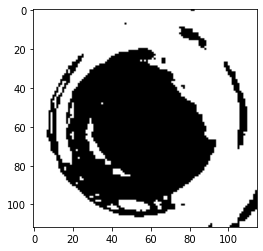

In [12]:
mask_temp = mask2
plt.imshow(mask_temp, cmap="gray")


(112, 115, 3) (55, 60, 3)
(60, 60, 3) (55, 60, 3)


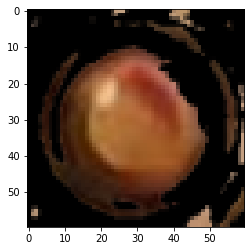

In [13]:
template2 = template.copy()
template2[mask1] = 0
temp = img2[2370:2425,215:275]
plt.imshow(template2, cmap="gray")

print(template2.shape, temp.shape)
resized = cv.resize(template2, (60,60), interpolation = cv.INTER_AREA)
print(resized.shape, temp.shape)
plt.imshow(resized, cmap="gray")

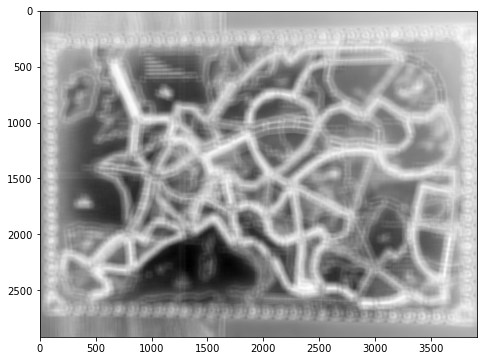

In [14]:
res = cv.matchTemplate(img2,resized,0)
min_val, max_val, min_loc, max_loc = cv.minMaxLoc(res)
plot_img(1-res)

In [15]:
1-res

array([[-1.33882272e+08, -1.33914048e+08, -1.33936896e+08, ...,
        -7.67529040e+07, -7.67338880e+07, -7.67168800e+07],
       [-1.33975928e+08, -1.34006912e+08, -1.34028216e+08, ...,
        -7.68211680e+07, -7.68018480e+07, -7.67841440e+07],
       [-1.34071184e+08, -1.34100088e+08, -1.34119352e+08, ...,
        -7.68883040e+07, -7.68683280e+07, -7.68496240e+07],
       ...,
       [-1.79468528e+08, -1.79559840e+08, -1.79650992e+08, ...,
        -1.22002360e+08, -1.22021880e+08, -1.22045872e+08],
       [-1.79381040e+08, -1.79470736e+08, -1.79563568e+08, ...,
        -1.21946576e+08, -1.21967184e+08, -1.21992040e+08],
       [-1.79308784e+08, -1.79396544e+08, -1.79489408e+08, ...,
        -1.21893576e+08, -1.21912744e+08, -1.21936808e+08]], dtype=float32)

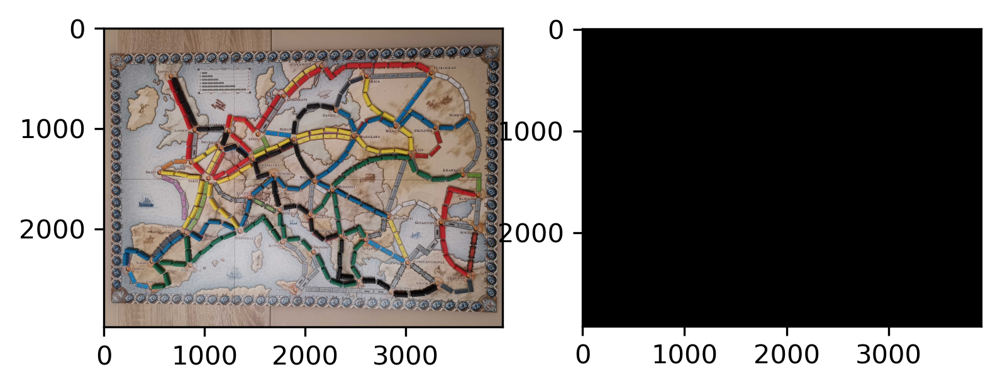

In [16]:
plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(res<25000000,cmap="gray")

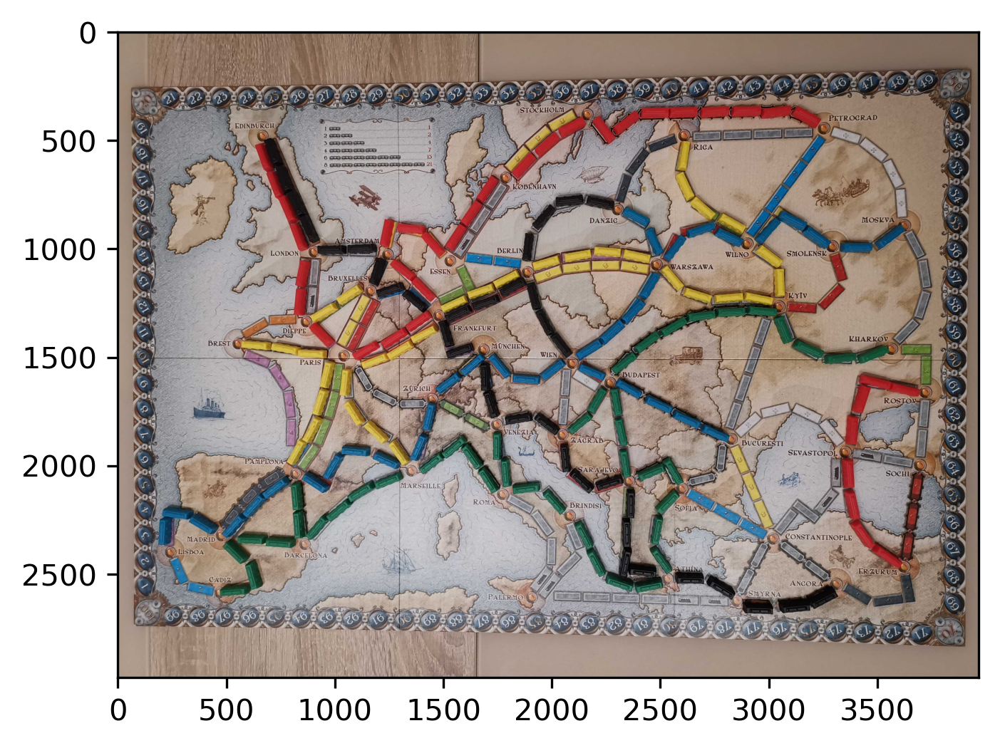

In [17]:
img_res = np.ascontiguousarray(img, dtype=np.uint8)
threshold = 21500000
w, h = temp.shape[0:2]
loc = np.where( res <= threshold)
for pt in zip(*loc[::-1]):
    cv.rectangle(img_res, pt, (pt[0] + w, pt[1] + h), (0,255,0), 2)
cv.imwrite('res2.png',img_res)

plt.figure(dpi=300)
plt.imshow(img_res)

In [18]:
from skimage.measure import label
def get_local_centers(corr,th=21500000):
    lbl, n = label(corr <= th, connectivity = 2, return_num=True)
    print(n)
    return np.int16([np.mean(np.argwhere(lbl == i),axis =0) for i in range(1, n+1)])

img_res = np.ascontiguousarray(img, dtype=np.uint8)
cities = get_local_centers(res)

0


In [19]:
loc = np.where( res <= threshold)
len(loc[1])
x = loc[0][0]
y = loc[1][0]
points = [[x,y]]
print(len(points), points)
for i in range(len(loc[1])):
    x1 = loc[0][i]
    y1 = loc[1][i]
    print("x1 y1 ", x1,y1)
    counter = 0
    for j in range(len(points)):
        print(len(points), "entering second loop len")
        x = points[j][0]
        y = points[j][1]
        print("difference x" , x1-x, "difference y:", y1-y)
        if abs(x1-x)>30 or abs(y1-y)>30:
            counter+=1
            print("add to counter")
    print("counter:", counter, "exited second loop len : ", len(points))
    if counter==len(points):
        points.append([x1,y1])
        #x = x1
        #y = y1

print(points)
        

               

IndexError: index 0 is out of bounds for axis 0 with size 0

In [20]:
img_res = np.ascontiguousarray(img, dtype=np.uint8)
th=22000000
w, h = temp.shape[0:2]
for pt in points:
    pt = (pt[1],pt[0])
    cv.rectangle(img_res, pt, (pt[0] + w, pt[1] + h), (0,255,0), 10)
cv.imwrite('res2.png',img_res)

plt.figure(dpi=300)
plt.imshow(img_res)

NameError: name 'points' is not defined

# template matching  that works best

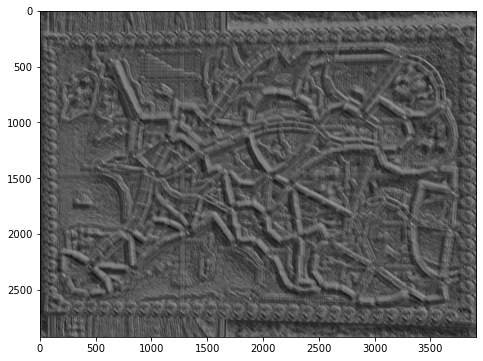

In [23]:
res = cv.matchTemplate(img2,temp,5)
min_val, max_val, min_loc, max_loc = cv.minMaxLoc(res)
plot_img(res)

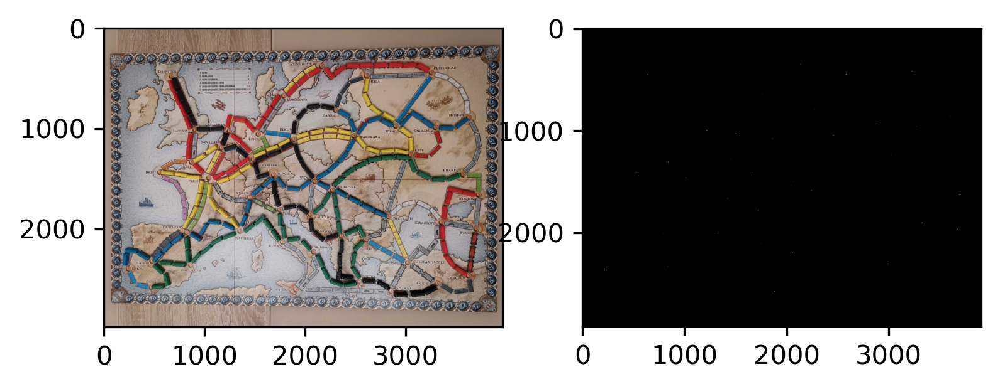

In [24]:
plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(res>0.5,cmap="gray")

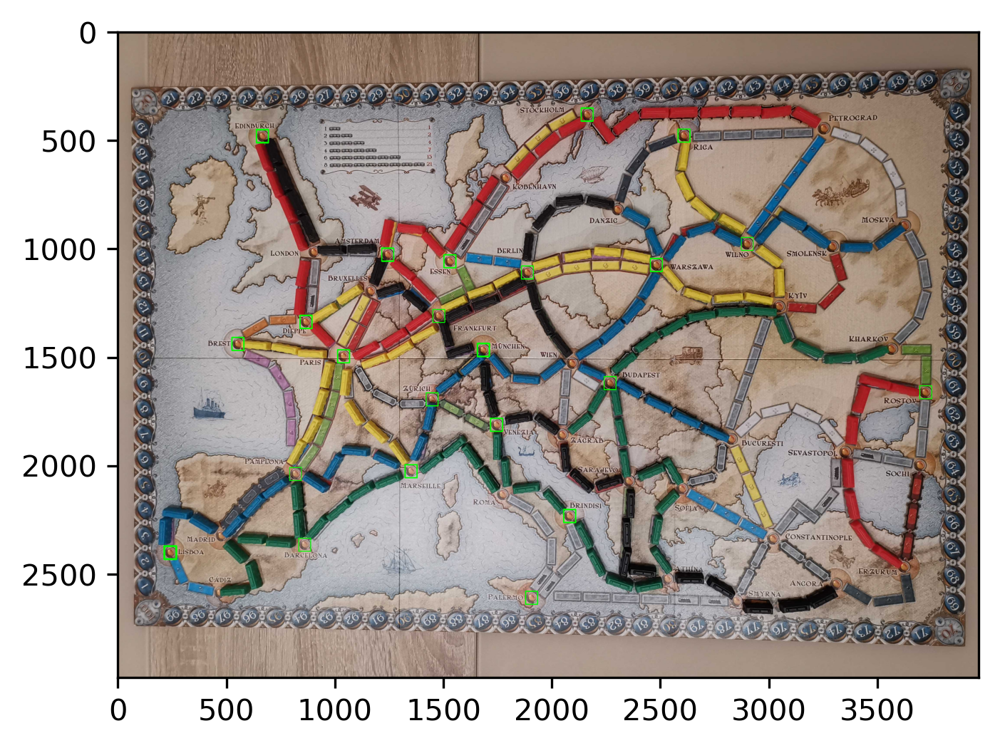

In [25]:
img_res = np.ascontiguousarray(img, dtype=np.uint8)
threshold = 0.57
w, h = temp.shape[0:2]
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv.rectangle(img_res, pt, (pt[0] + w, pt[1] + h), (0,255,0), 2)
cv.imwrite('res2.png',img_res)

plt.figure(dpi=300)
plt.imshow(img_res)

In [26]:
from sklearn.cluster import AgglomerativeClustering
loc = np.where(res >= threshold)
loc = np.stack(loc[::-1]).T
clustering = AgglomerativeClustering(n_clusters=None, distance_threshold = 100)
clustering.fit(loc)
clusters = clustering.labels_

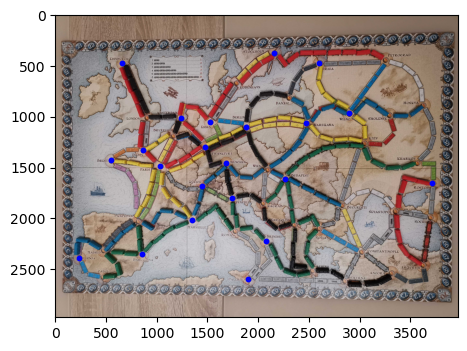

In [27]:
cit = []
#loc[clusters==1]

for i in range(clusters.max()):
    clust = loc[clusters==i]
    #print(i)
    clust_x = np.dstack((clust))[0][0]
    clust_y = np.dstack((clust))[0][1]
    #print(clust_x.mean(),clust_y.mean())
    cit.append([clust_x.mean()+20,clust_y.mean()+20])

cit = np.dstack(cit)
plt.figure(dpi=100)
plt.imshow(img)
plt.scatter(cit[:,0],cit[:,1], s=10, c="b")

# Color spaces - find trains


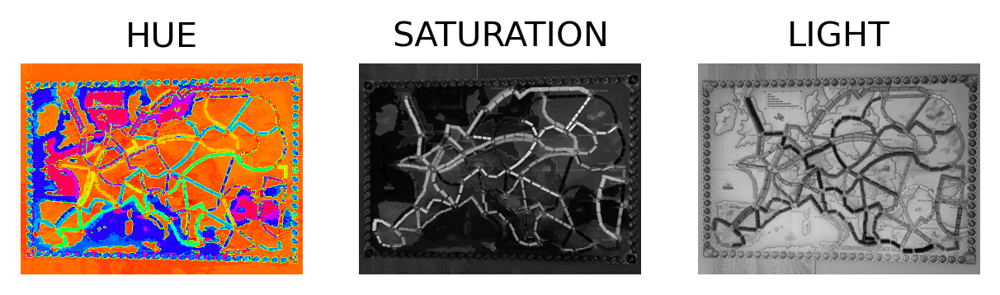

In [28]:
HLS = cv.cvtColor(img, cv.COLOR_RGB2HLS)

HUE = HLS[:, :, 0]              # Split attributes
LIGHT = HLS[:, :, 1]
SAT = HLS[:, :, 2]

plt.figure(dpi=250)
plt.subplot(1,3,1)              # Plot color attributes
plt.imshow(HUE, cmap='hsv')
plt.title('HUE')
plt.axis('off')
plt.subplot(1,3,2)
plt.imshow(SAT, cmap='gray')
plt.title('SATURATION')
plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(LIGHT, cmap='gray')
plt.title('LIGHT')
plt.axis('off')
plt.show()

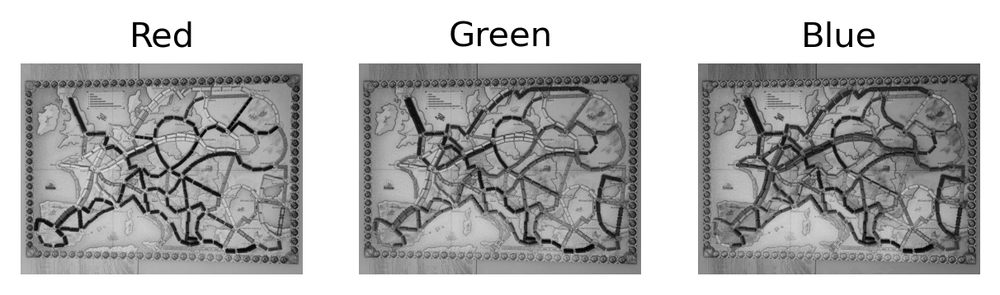

In [29]:
R = img[:, :, 0]              # Split attributes
G = img[:, :, 1]
B = img[:, :, 2]

plt.figure(dpi=250)
plt.subplot(1,3,1)              # Plot color attributes
plt.imshow(R, cmap='gray')
plt.title('Red')
plt.axis('off')
plt.subplot(1,3,2)
plt.imshow(G, cmap='gray')
plt.title('Green')
plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(B, cmap='gray')
plt.title('Blue')
plt.axis('off')
plt.show()

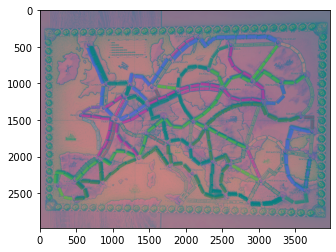

In [30]:
def rgb2ycbcr(im):
    xform = np.array([[.299, .587, .114], [-.1687, -.3313, .5], [.5, -.4187, -.0813]])
    ycbcr = im.dot(xform.T)
    ycbcr[:,:,[1,2]] += 128
    return np.uint8(ycbcr)
imgYCrCb = rgb2ycbcr(img)
plt.imshow(imgYCrCb)

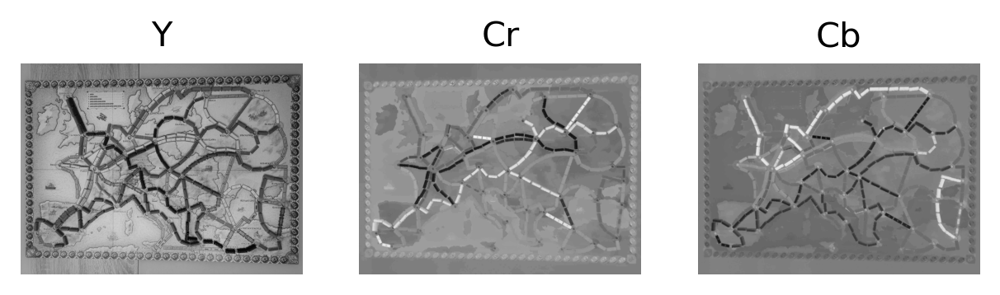

In [31]:
Y = imgYCrCb[:, :, 0]              # Split attributes
Cr = imgYCrCb[:, :, 1]
Cb = imgYCrCb[:, :, 2]

plt.figure(dpi=250)
plt.subplot(1,3,1)              # Plot color attributes
plt.imshow(Y, cmap='gray')
plt.title('Y')
plt.axis('off')
plt.subplot(1,3,2)
plt.imshow(Cr, cmap='gray')
plt.title('Cr')
plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(Cb, cmap='gray')
plt.title('Cb')
plt.axis('off')
plt.show()

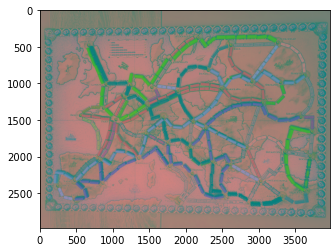

In [32]:
img_lab = cv.cvtColor(img, cv.COLOR_BGR2Lab)
plt.imshow(img_lab)

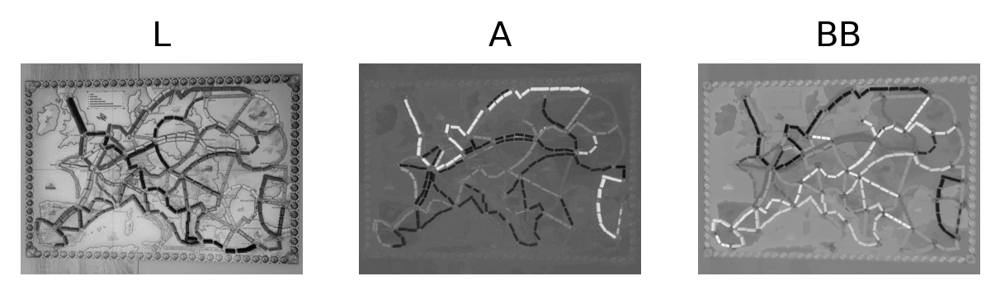

In [33]:
L = img_lab[:, :, 0]              # Split attributes
A = img_lab[:, :, 1]
BB = img_lab[:, :, 2]

plt.figure(dpi=250)
plt.subplot(1,3,1)              # Plot color attributes
plt.imshow(L, cmap='gray')
plt.title('L')
plt.axis('off')
plt.subplot(1,3,2)
plt.imshow(A, cmap='gray')
plt.title('A')
plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(BB, cmap='gray')
plt.title('BB')
plt.axis('off')
plt.show()

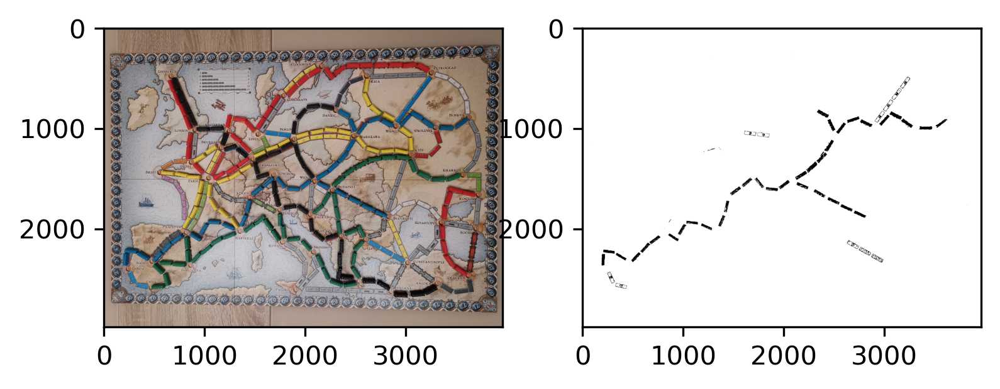

In [34]:
#blue
mask_blue =  (Cr > 165) | (Cr < 154) | (B > 172)
img2_blue = img.copy()
# img2[mask] = 0

plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2_blue)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_blue, cmap="gray")

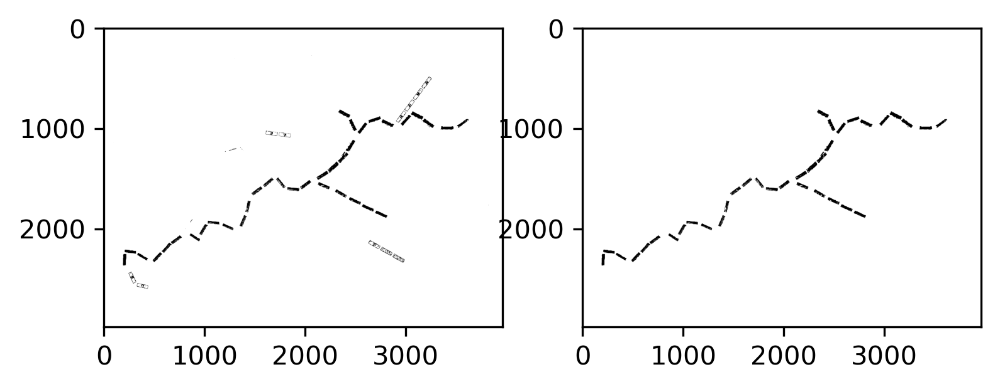

In [35]:
from skimage import morphology


mask_blue_clean = morphology.remove_small_objects(mask_blue, min_size=100, connectivity=2, in_place=False)
mask_blue_clean = morphology.remove_small_holes(mask_blue, area_threshold=2000, connectivity=2, in_place=False)
plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(mask_blue,cmap="gray")
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_blue_clean, cmap="gray")

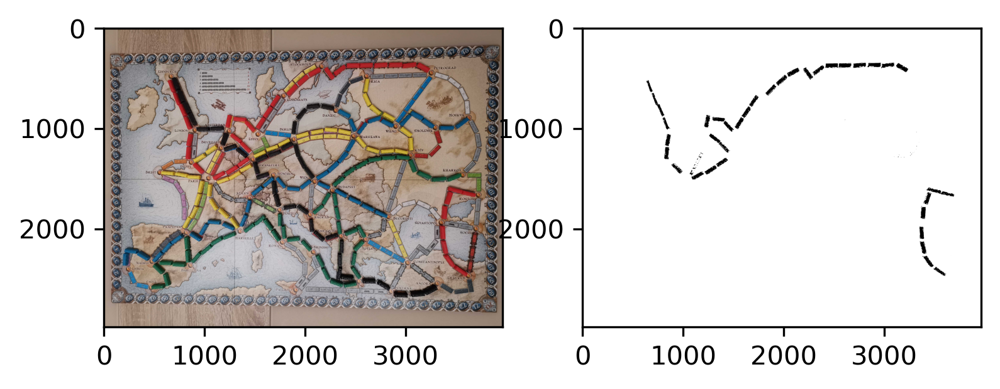

In [36]:
#red
mask_red =  (Cb > 210) | (Cb < 180) | (R < 150) | (HUE < 178) 
img2_red = img.copy()
# img2[mask] = 0

plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2_red)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_red, cmap="gray")

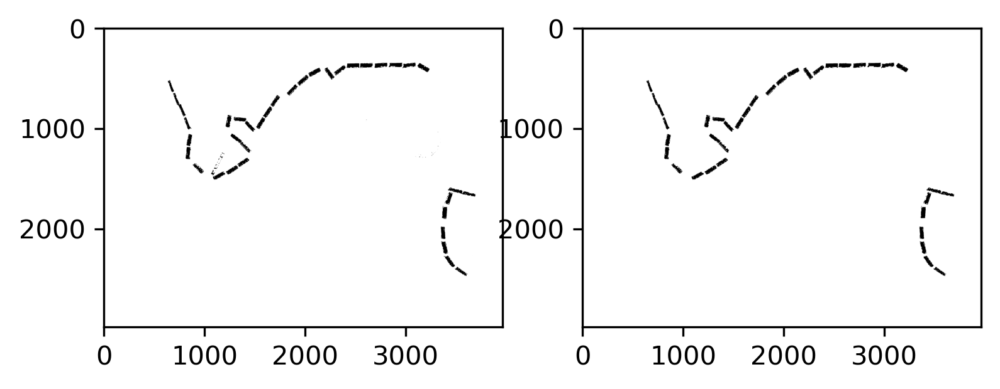

In [37]:
mask_red_clean = morphology.remove_small_objects(mask_red, min_size=60, connectivity=2, in_place=False)
mask_red_clean = morphology.remove_small_holes(mask_red, area_threshold=950, connectivity=2, in_place=False)
plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(mask_red,cmap="gray")
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_red_clean, cmap="gray")

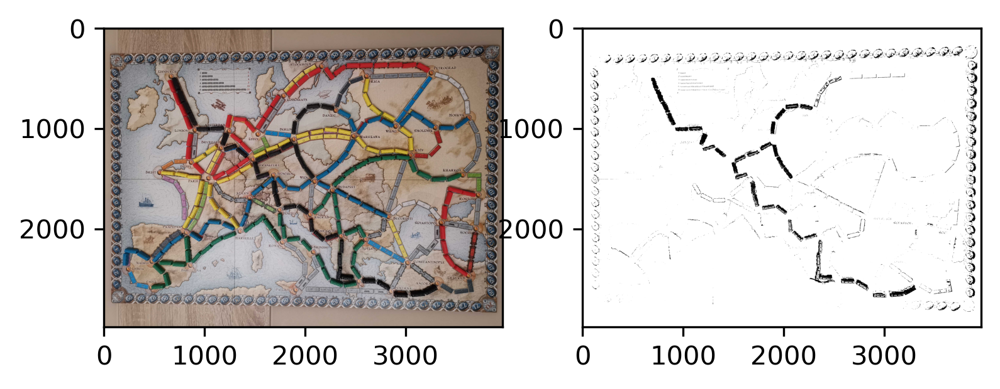

In [38]:
#black
#mask_black =(L > 0) & (L < 50) & (SAT > 0) & (SAT < 70) & (Y > 0) & (Y < 70)
mask_black =  (Cb<125)| (Cb>155)|(G>45)|(R>50)|(R<0)|(SAT>60)
img2_black = img.copy()
# img2[mask] = 0

plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2_black)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_black, cmap="gray")

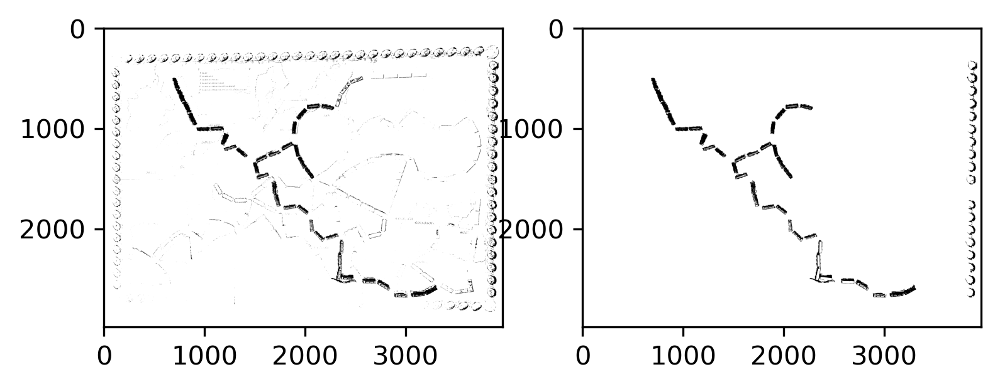

In [39]:
mask_black_clean = morphology.remove_small_objects(mask_black, min_size=10, connectivity=2, in_place=False)
mask_black_clean = morphology.remove_small_holes(mask_black, area_threshold=2000, connectivity=2, in_place=False)
plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(mask_black,cmap="gray")
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_black_clean, cmap="gray")

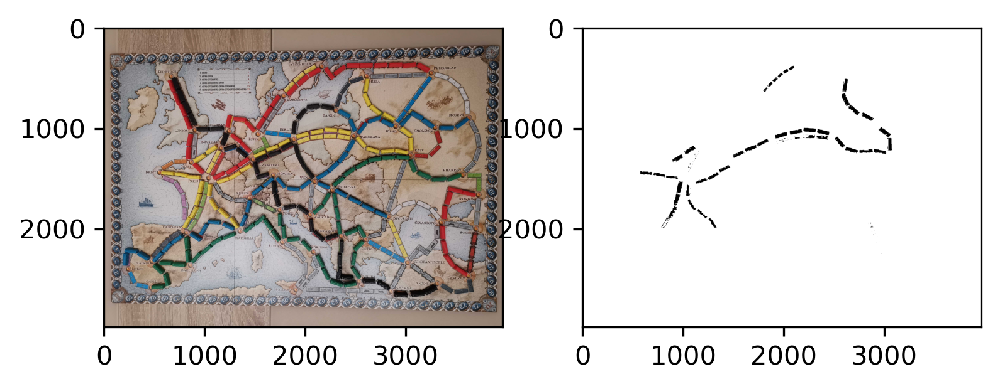

In [40]:
#yellow
#mask_yellow = (HUE < 23) | (HUE > 25)|(Cr>82)
mask_yellow = (BB < 103) | (BB > 107.5)|(Cr>82)
img2_yellow = img.copy()
# img2[mask] = 0

plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2_yellow)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_yellow, cmap="gray")

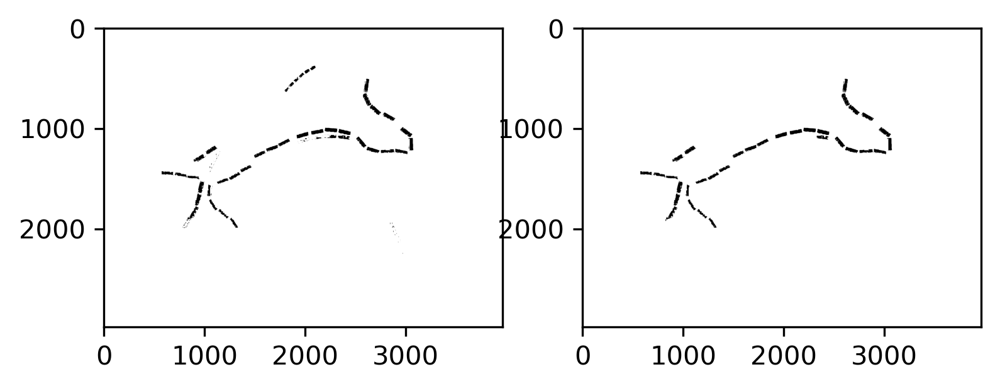

In [41]:
mask_yellow_clean = morphology.remove_small_objects(mask_yellow, min_size=400, connectivity=2, in_place=False)
mask_yellow_clean = morphology.remove_small_holes(mask_yellow, area_threshold=2000, connectivity=2, in_place=False)
plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(mask_yellow,cmap="gray")
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_yellow_clean, cmap="gray")

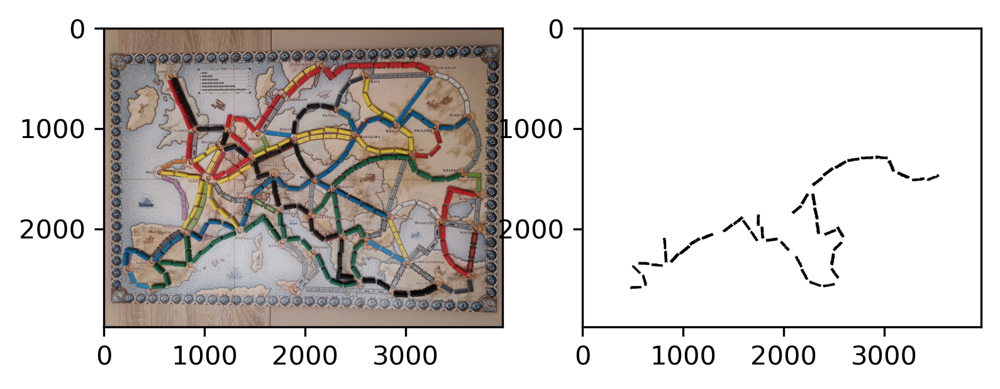

In [42]:
#green
mask_green = (HUE < 75) | (HUE > 82)|(Cb>106)
img_green = img.copy()
# img2[mask] = 0

plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img_green)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_green, cmap="gray")


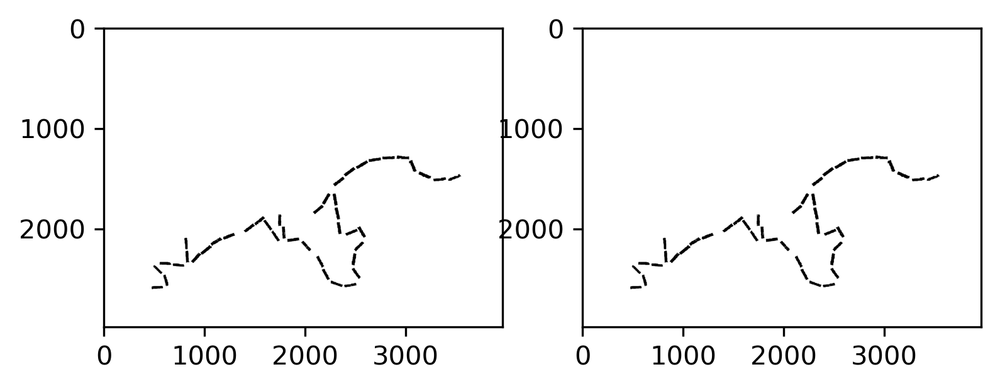

In [43]:
mask_green_clean = morphology.remove_small_objects(mask_green, min_size=30, connectivity=2, in_place=False)
mask_green_clean = morphology.remove_small_holes(mask_green, area_threshold=2000, connectivity=2, in_place=False)
plt.figure(dpi=300)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(mask_green,cmap="gray")
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask_green_clean, cmap="gray")

In [75]:
def plot_cont(mask_clean):
    mask_int = mask_clean.astype(np.uint8)
    contours, hierarchy = cv.findContours(mask_int, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)
    img_cnt = img.copy()
    #print(contours)
    cv.drawContours(img_cnt, contours, -1, (100,40,255), 10)
    plt.figure(dpi=150)
    plt.imshow(img_cnt)
    return contours, hierarchy 

In [76]:
def get_shpae(approx):
    if len(approx) == 3:
        shape = "triangle"
    elif len(approx) == 4:
#         (x, y, w, h) = cv2.boundingRect(approx)
        
        area = cv.contourArea(approx)
        perimeter = cv.arcLength(approx, True) 
        ar = area * 16 / perimeter**2
        shape = "square" if ar >= 0.95 and ar <= 1.05 else "rectangle"
    else:
        shape = "circle"
    return shape
#get_shpae(approx)

In [91]:
def trains_cord(contours, hierarchy):
    trains = []
    for i in range(len(contours)):
        if hierarchy[0][i][-1] != 0:
            continue
        if cv.contourArea(contours[i]) < 100:
            continue
        perimeter = cv.arcLength(contours[i], True)
        approx = cv.approxPolyDP(contours[i], 0.04 * perimeter, True)
        shape = get_shpae(approx)
        M = cv.moments(contours[i])
        cX = int((M["m10"] / M["m00"]))
        cY = int((M["m01"] / M["m00"]))
        pos = "x - " + str(cX) +", y - "+str(cY)
        if cX<(img_cnt.shape[1]-200):
            trains.append([cX,cY])
            if M["m00"] < 100:
                continue
            cv.putText(img_cnt, "*", (cX, cY), cv.FONT_HERSHEY_SIMPLEX,
                2, (255, 255, 255), 3)
    print("therea are",len(trains),"trains")
    plt.figure(dpi=250)    
    plt.imshow(img_cnt)
    return trains

In [78]:
img_cnt.shape[1]

3968

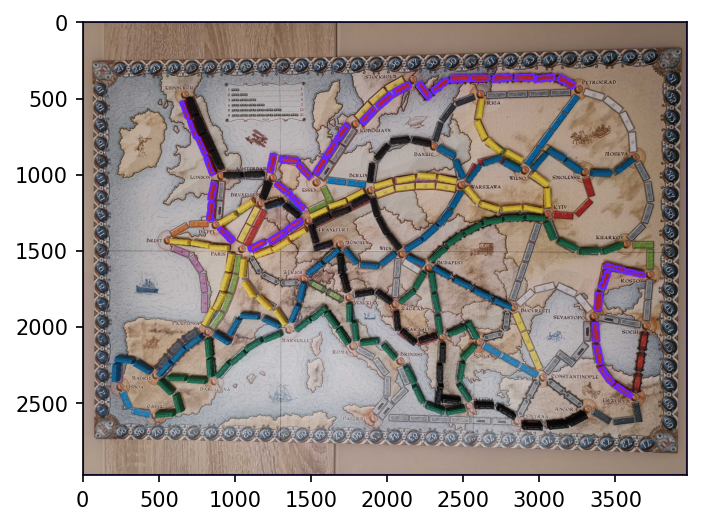

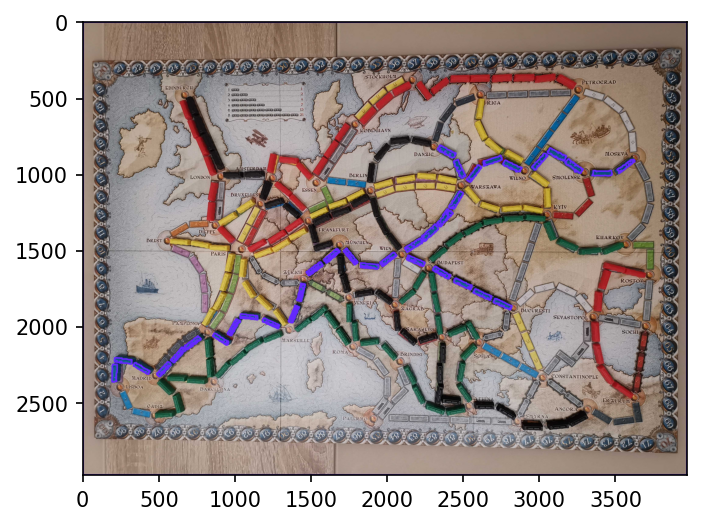

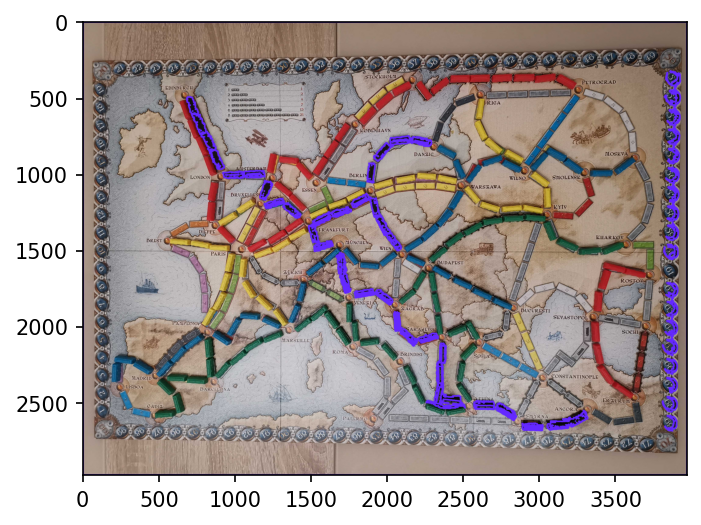

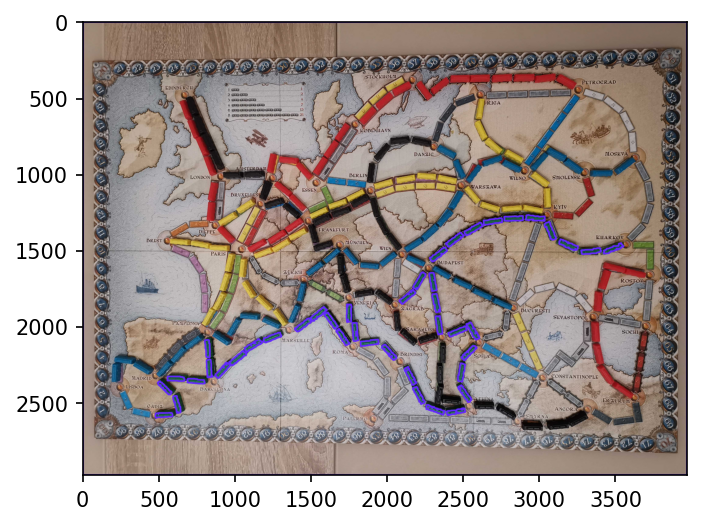

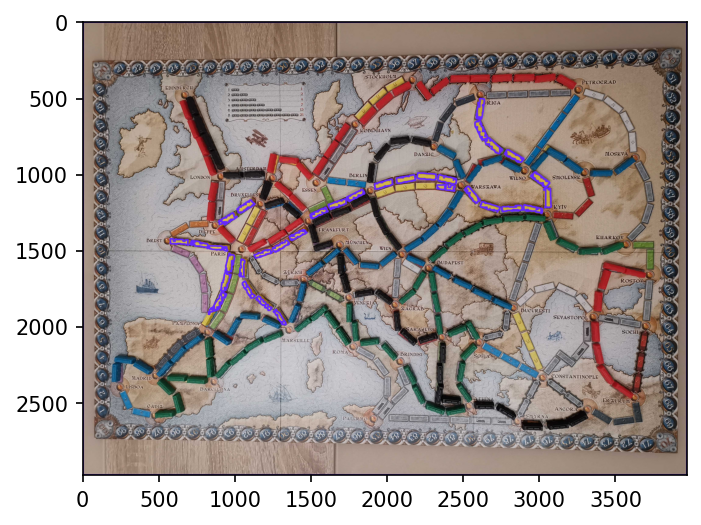

In [79]:
red_cont = plot_cont(mask_red_clean)
blue_cont = plot_cont(mask_blue_clean)
black_cont = plot_cont(mask_black_clean)
green_cont = plot_cont(mask_green_clean)
yellow_cont = plot_cont(mask_yellow_clean)

In [90]:
red_cont[1]

array([[[ -1,  -1,   1,  -1],
        [  2,  -1,  -1,   0],
        [  3,   1,  -1,   0],
        ...,
        [ -1, 439, 446,   0],
        [447,  -1,  -1, 445],
        [ -1, 446,  -1, 445]]], dtype=int32)

therea are 35 trains
therea are 36 trains
therea are 40 trains
therea are 42 trains
therea are 33 trains


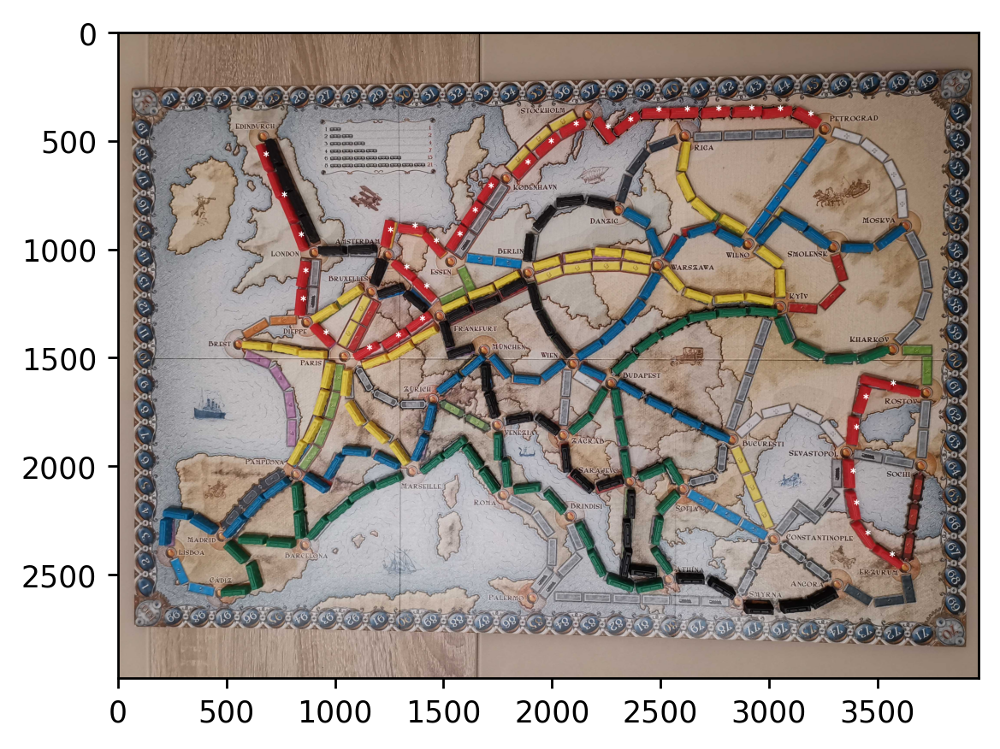

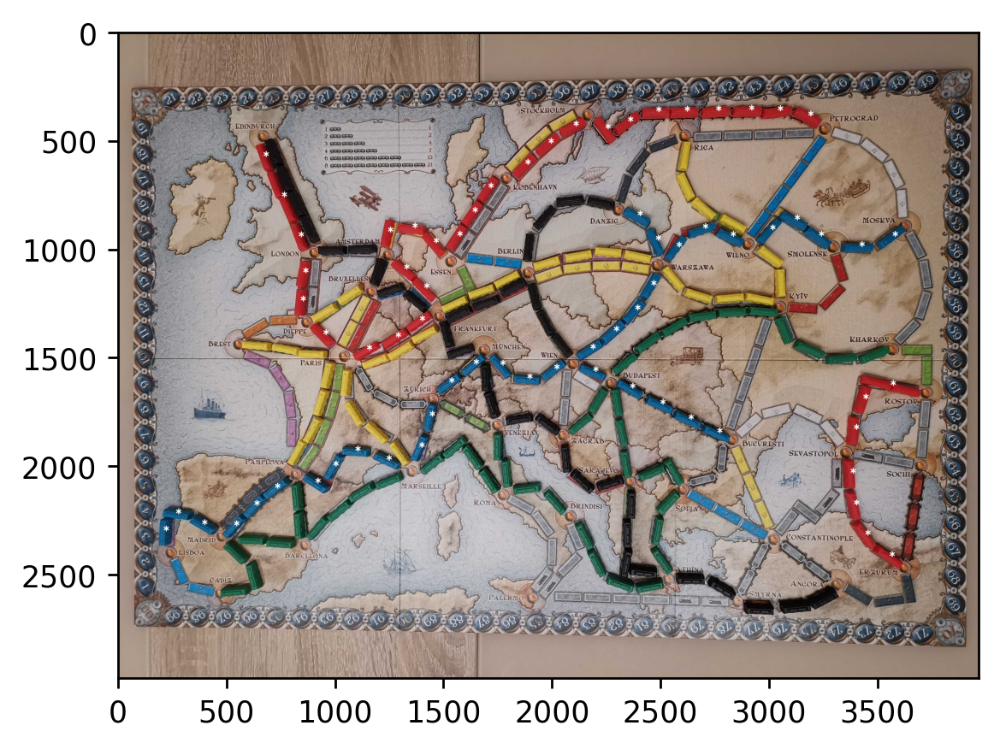

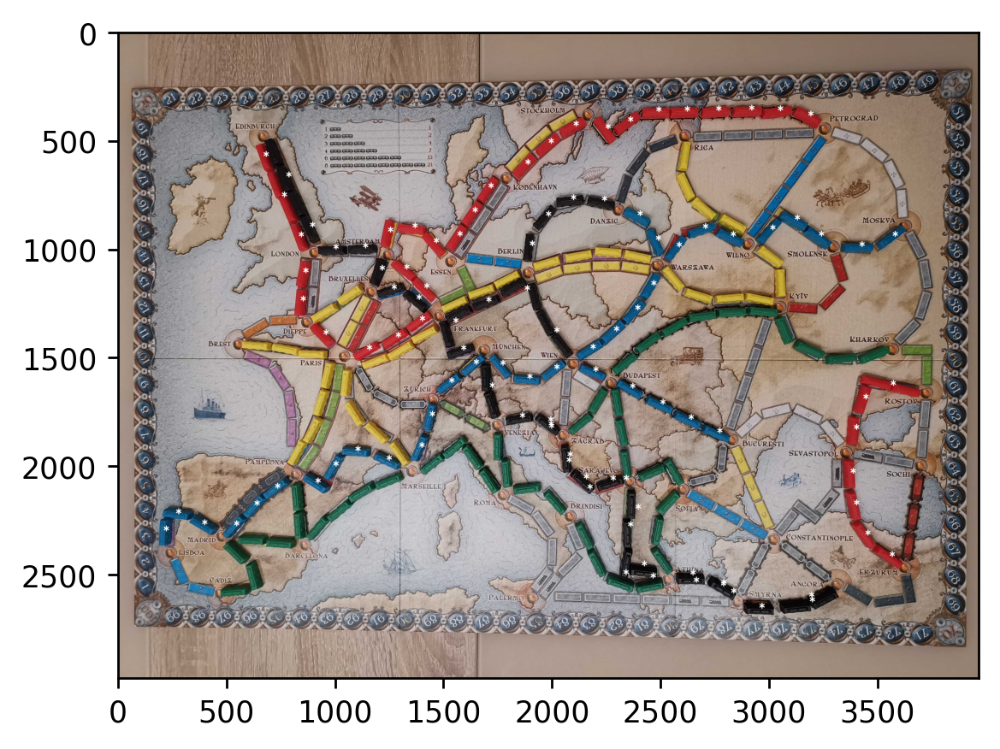

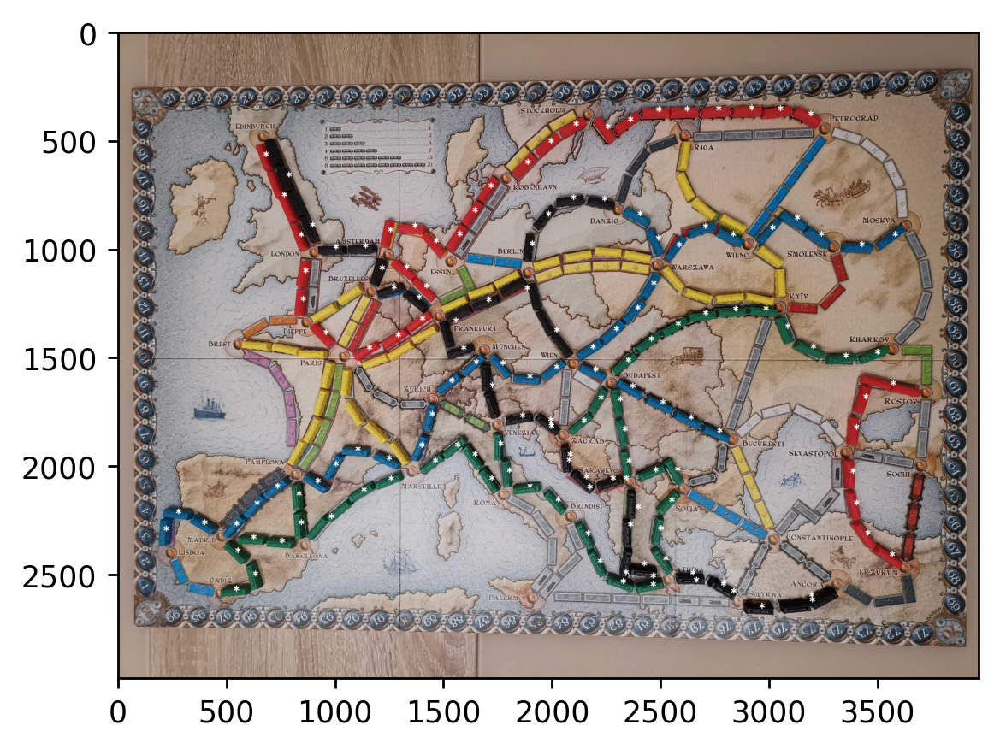

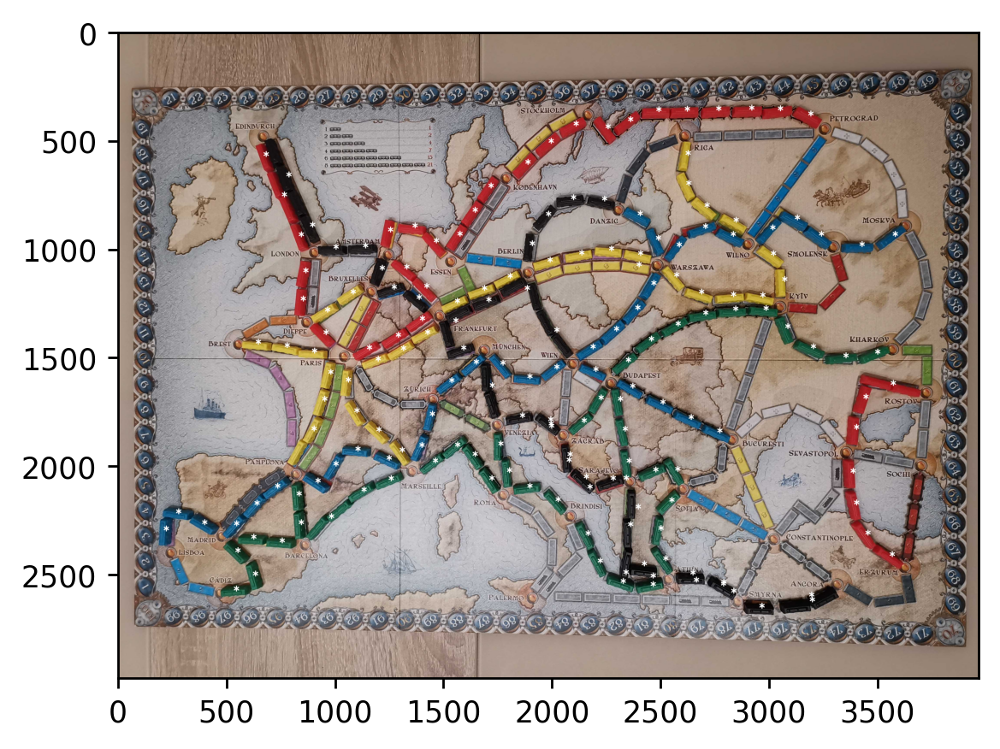

In [92]:
img_cnt = img.copy()
red_trains = trains_cord(red_cont[0],red_cont[1])
blue_trains = trains_cord(blue_cont[0],blue_cont[1])
black_trains = trains_cord(black_cont[0],black_cont[1])
green_trains = trains_cord(green_cont[0],green_cont[1])
yellow_trains = trains_cord(yellow_cont[0], yellow_cont[1])

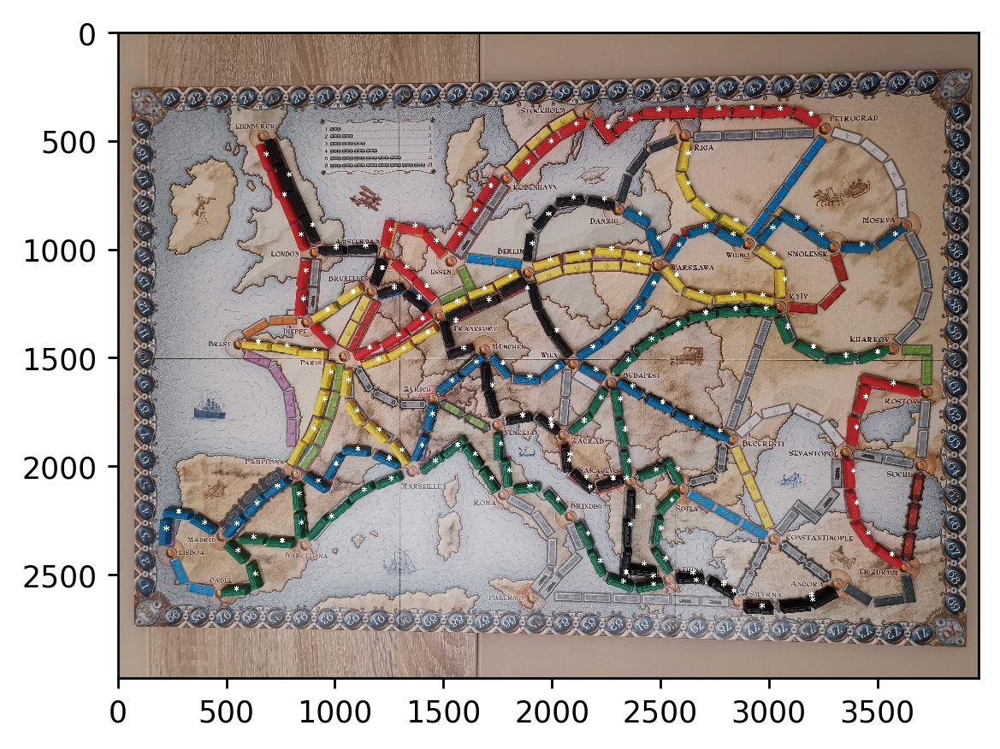

In [338]:
plt.figure(dpi=250)
plt.imshow(img_cnt)

In [333]:
red_cont

(array([[1, 1, 1, ..., 1, 1, 1],
        [1, 1, 1, ..., 1, 1, 1],
        [1, 1, 1, ..., 1, 1, 1],
        ...,
        [1, 1, 1, ..., 1, 1, 1],
        [1, 1, 1, ..., 1, 1, 1],
        [1, 1, 1, ..., 1, 1, 1]], dtype=uint8),
 [array([[[   0,    0]],
  
         [[   0, 2975]],
  
         [[3967, 2975]],
  
         [[3967,    0]]], dtype=int32),
  array([[[3515, 2416]],
  
         [[3516, 2415]],
  
         [[3517, 2416]],
  
         [[3516, 2417]]], dtype=int32),
  array([[[3558, 2415]],
  
         [[3559, 2414]],
  
         [[3560, 2415]],
  
         [[3559, 2416]]], dtype=int32),
  array([[[3522, 2386]],
  
         [[3523, 2385]],
  
         [[3524, 2386]],
  
         [[3523, 2387]]], dtype=int32),
  array([[[3467, 2379]],
  
         [[3468, 2378]],
  
         [[3469, 2379]],
  
         [[3468, 2380]]], dtype=int32),
  array([[[3510, 2377]],
  
         [[3514, 2377]],
  
         [[3515, 2378]],
  
         [[3516, 2378]],
  
         [[3521, 2383]],
  
         [[352

In [ ]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt
img_rgb = cv.imread('black_blue_green.jpg')
#img_rgb = img_rgb[..., ::-1]
img_gray = cv.cvtColor(img_rgb, cv.COLOR_BGR2GRAY)
template = cv.imread('template.jpg',0)
plt.imshow(template)
w, h = template.shape[::-1]
res = cv.matchTemplate(img_gray,template,cv.TM_CCOEFF_NORMED)
threshold = 0.4
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    print('g')
    img_sol = cv.rectangle(img_rgb, pt, (pt[0] + w, pt[1] + h), (252,15,192), 2)

#img_sol = img_sol[..., ::-1]
cv.imwrite('res.png',img_rgb)


In [ ]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt
img_rgb = cv.imread('black_blue_green.jpg')
img_gray = cv.cvtColor(img_rgb, cv.COLOR_BGR2GRAY)
template = cv.imread('template.jpg',0)
w, h = template.shape[::-1]
res = cv.matchTemplate(img_gray,template,cv.TM_CCOEFF_NORMED)
threshold = 0.4
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    print('g')
    cv.rectangle(img_rgb, pt, (pt[0] + w, pt[1] + h), (0,0,255), 2)
cv.imwrite('res1.png',img_rgb)

In [ ]:
plt.hist(HUE[200:890,3200:3500]);